In [1]:
using CSV
using DataFrames
using Plots

# ファイル読み込み

In [3]:
FILE_NAME = "../output/CircleModel_20240726_152413.csv"
# FILE_NAME = "../output/CircleModel_20240826_111618.csv"
# FILE_NAME = "../output/CircleModel_20240826_144719.csv"  # detailed sigma R, 10 trials
# FILE_NAME = "../output/CircleModel_20240826_182404.csv"  # detailed sigma R, 10 trials
# FILE_NAME = "../output/CircleModel_20240826_200917.csv"  # β ∈ 0.0:0.1:0.9, sigmaθ ∈ {0.01, 0.1, 0.2, 0.3}, 10 trials
# FILE_NAME = "../output/CircleModel_20240827_100534.csv"  # all, 10 trials

df = CSV.File(FILE_NAME) |> DataFrame
replace!(df.peak_node_variability, -1 => 99)  # -1は無限大の変動を表している。ソートの都合で99に置換する。
size(df)

(2160, 17)

In [4]:
function one_plot(df::SubDataFrame, xticks::Vector, xlabel::String, title::String)::Plots.Plot
    p = plot(
        xticks=(1:length(xticks), xticks),
        # xticks=(0:49, [x in [1, 2, 3, 5, 9, 17, 33] ? "$(x-1)" : "" for x in 0:49]),
        # xscale=:log2,
        xlim=(1, length(xticks)),
        yticks=0:0.1:1,
        ylim=(0,1),
        xlabel=xlabel,
        ylabel="Cooperation",
        title=title,
    )

    for _df in groupby(df, [:b])
        if length(p_vec) == 2
            plot!(_df.cooperation_rate, label="b=$(_df.b[1])")
        else
            plot!(_df.cooperation_rate, label=false)
        end
    end

    return p
end;

In [5]:
xticks_peak_node_variability = [x == 99 ? "Max" : string(x) for x in sort(unique(df.peak_node_variability))]
xlabel_peak_node_variability = "Prime Node Variability (\\sigma_{R})"
xticks_resource_limit_β = sort(unique(df.resource_limit_β))
xlabel_resource_limit_β = "Threshold Variability (\\beta)";

# 1. (peak, resource_limit) = (変動, 固定), (固定, 固定)

- 条件:
    - resource_limit_β = 0.0
    - resource_limit_σ = 0.0
- 中区分: (C_rate₀, relationship_increment_factor), 小区分: b
- 横軸: peak_node_variability

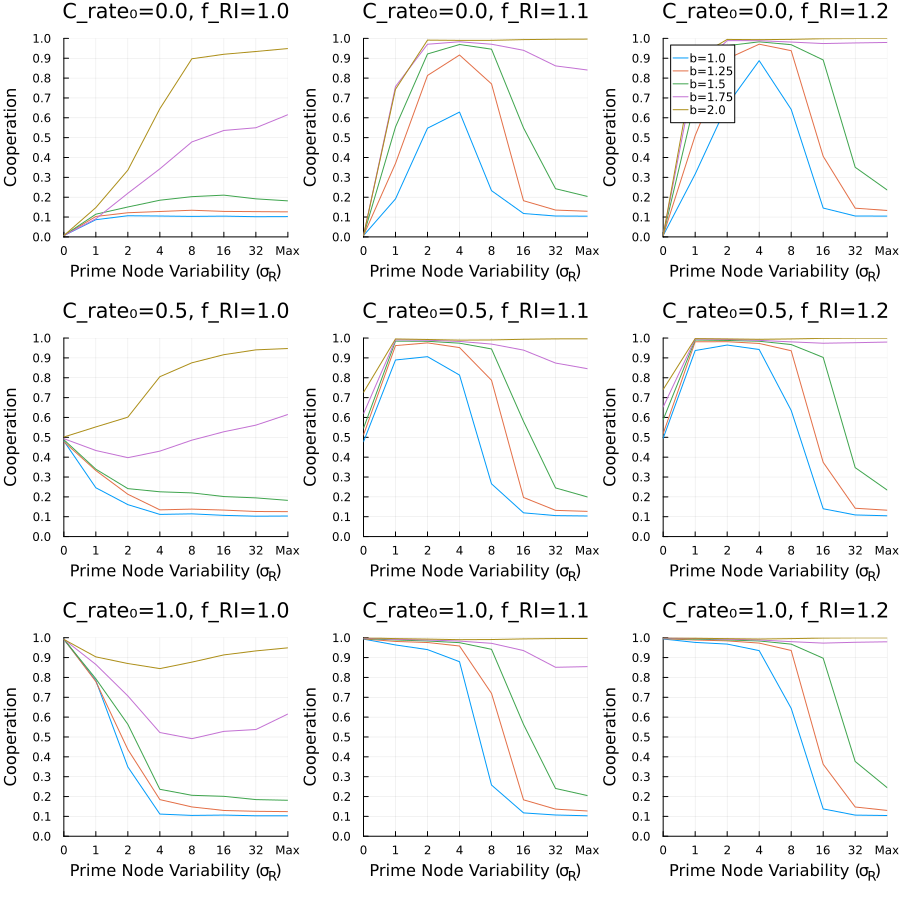

In [7]:
df = sort(df, [:C_rate₀, :relationship_increment_factor, :b, :peak_node_variability])
p_vec = []

for _df in groupby(df[df.resource_limit_β .== 0 .&& df.resource_limit_σ .== 0, :], [:C_rate₀, :relationship_increment_factor])
    title = "C_rate₀=$(_df[1, :C_rate₀]), f_RI=$(_df[1, :relationship_increment_factor])"
    push!(p_vec, one_plot(_df, xticks_peak_node_variability, xlabel_peak_node_variability, title))
end

plot(p_vec..., layout=(3, 3), size=(900, 900)) |> display

# 2. (peak, resource_limit) = (固定, 変動)

- 条件: peak_node_variability = 0.0
- 中区分: (C_rate₀, relationship_increment_factor), 小区分: b
- 横軸: resource_limit_β

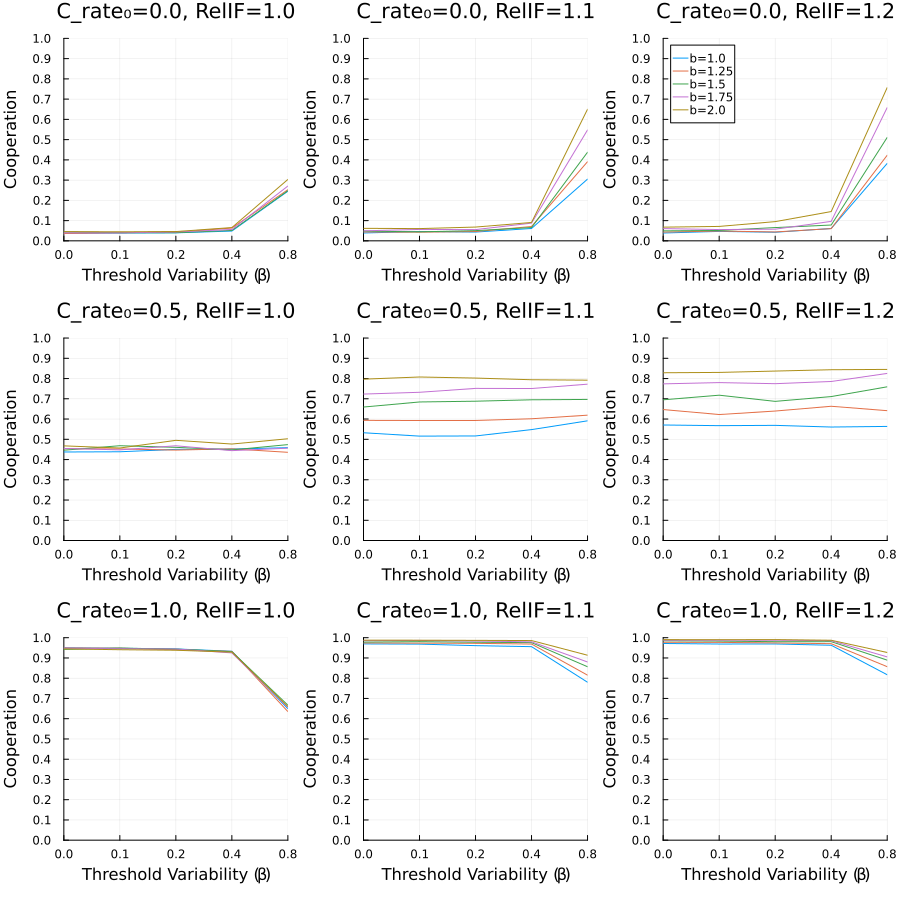

In [9]:
df = sort(df, [:C_rate₀, :relationship_increment_factor, :b, :resource_limit_β])
p_vec = []

for _df in groupby(df[df.peak_node_variability .== 0 .&& df.resource_limit_σ .== 0.1, :], [:C_rate₀, :relationship_increment_factor])
    title = "C_rate₀=$(_df[1, :C_rate₀]), RelIF=$(_df[1, :relationship_increment_factor])"
    push!(p_vec, one_plot(_df, xticks_resource_limit_β, xlabel_resource_limit_β, title))
end

plot(p_vec..., layout=(3, 3), size=(900, 900)) |> display

# 3. (peak, resource_limit) = (変動, 変動)

- 条件: resource_limit_σ = 0.1
- 大区分: C_rate₀, 中区分: (relationship_increment_factor, resource_limit_β), 小区分: b
- 横軸: peak_node_variability

C_rate₀=0.0


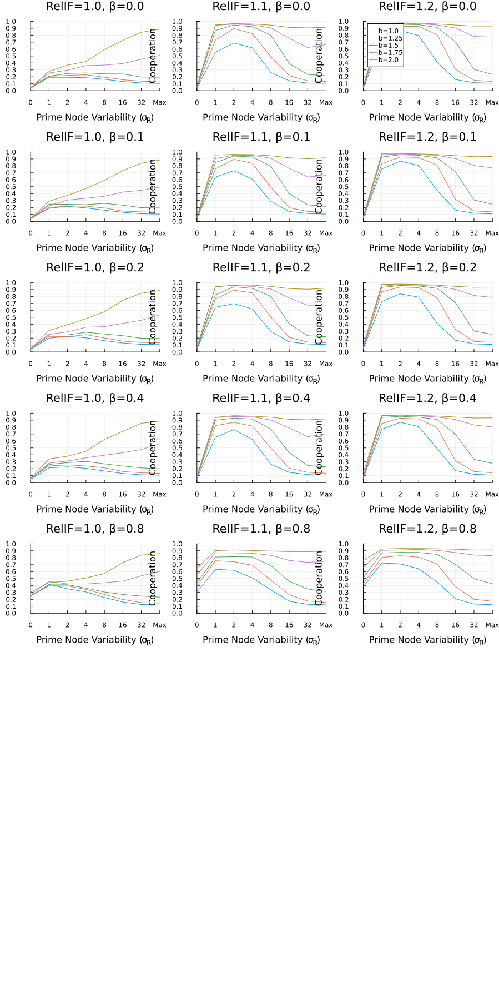

C_rate₀=0.5


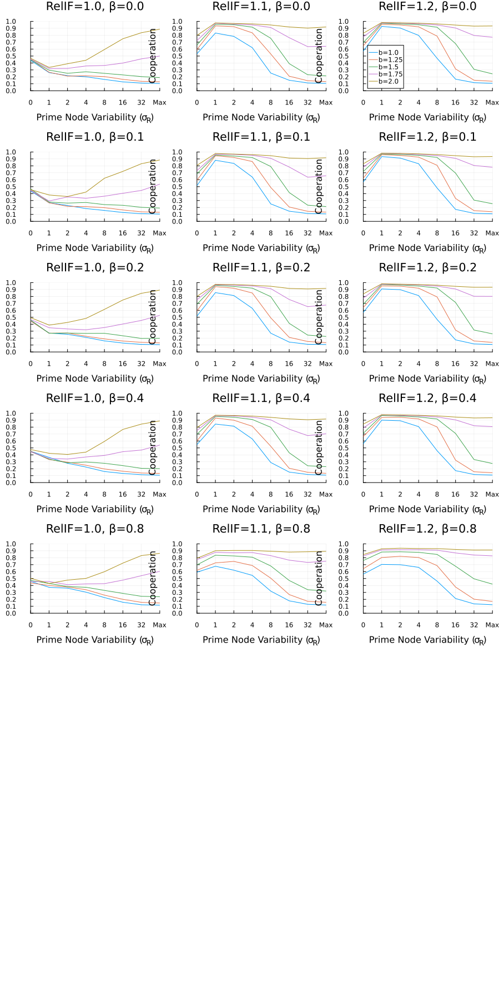

C_rate₀=1.0


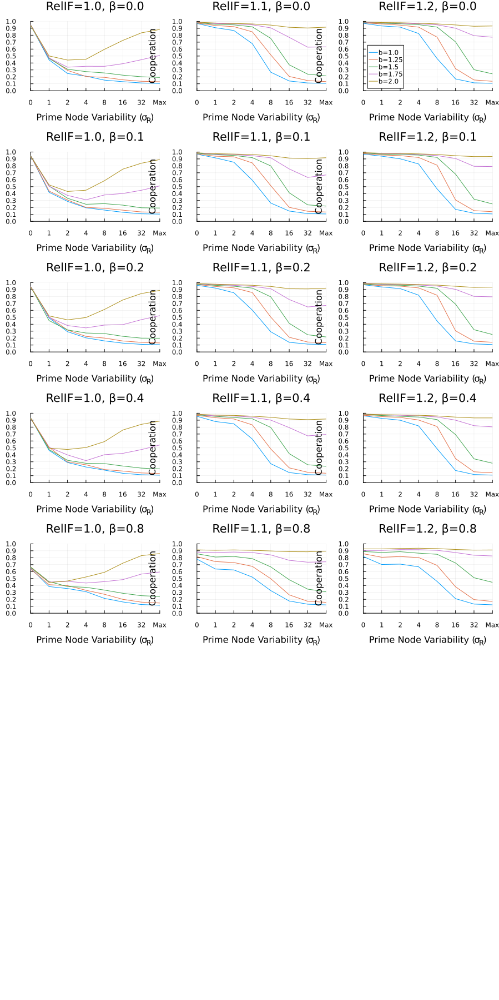

In [11]:
df = sort(df, [:C_rate₀, :resource_limit_β, :relationship_increment_factor, :b, :peak_node_variability])

for C_rate₀ in sort(unique(df.C_rate₀))
    println("C_rate₀=$(C_rate₀)")
    p_vec = []

    for _df in groupby(df[df.C_rate₀ .== C_rate₀ .&& df.resource_limit_σ .== 0.1, :], [:resource_limit_β, :relationship_increment_factor])
        title = "RelIF=$(_df[1, :relationship_increment_factor]), β=$(_df[1, :resource_limit_β])"
        push!(p_vec, one_plot(_df, xticks_peak_node_variability, xlabel_peak_node_variability, title))
    end

    # plot(p_vec..., layout=(5, 3), size=(900, 1200)) |> display
    plot(p_vec..., layout=(10, 3), size=(900, 1800)) |> display
end;

- 条件: resource_limit_σ = 0.1
- 大区分: C_rate₀, 中区分: (relationship_increment_factor, peak_node_variability), 小区分: b
- 横軸: resource_limit_β

C_rate₀=0.0


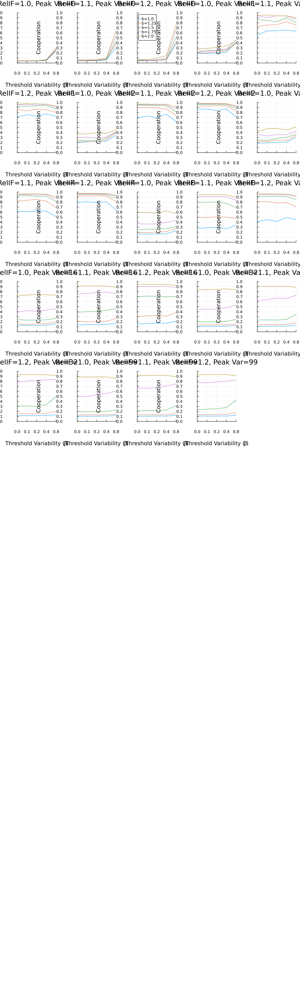

C_rate₀=0.5


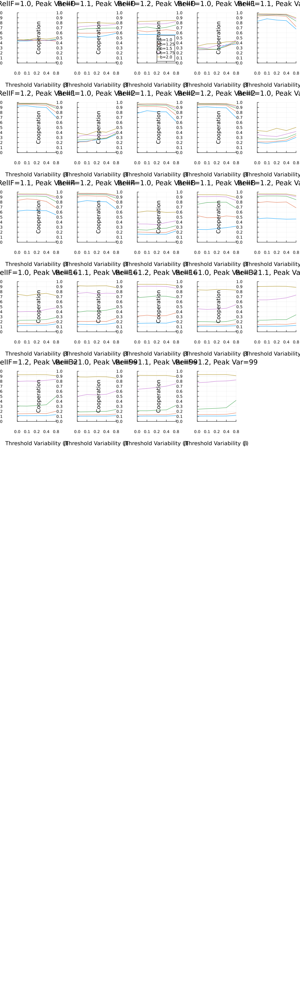

C_rate₀=1.0


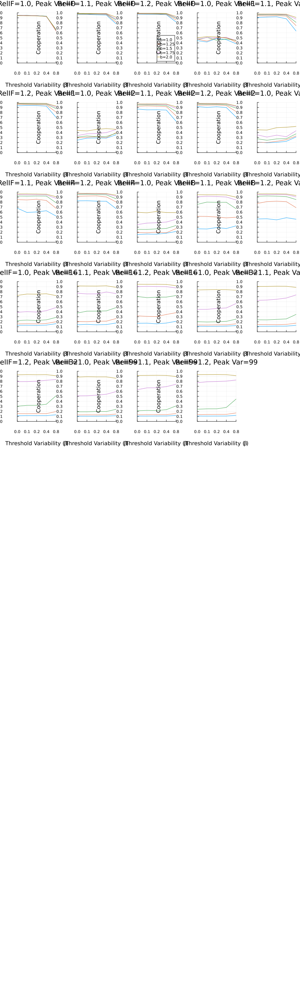

In [13]:
df = sort(df, [:C_rate₀, :peak_node_variability, :relationship_increment_factor, :b, :resource_limit_β])

for C_rate₀ in sort(unique(df.C_rate₀))
    println("C_rate₀=$(C_rate₀)")
    p_vec = []

    for _df in groupby(df[df.C_rate₀ .== C_rate₀ .&& df.resource_limit_σ .== 0.1, :], [:peak_node_variability, :relationship_increment_factor])
        title = "RelIF=$(_df[1, :relationship_increment_factor]), Peak Var=$(_df[1, :peak_node_variability])"
        push!(p_vec, one_plot(_df, xticks_resource_limit_β, xlabel_resource_limit_β, title))
    end

    # plot(p_vec..., layout=(8, 3), size=(900, 2000)) |> display
    plot(p_vec..., layout=(16, 5), size=(900, 3000)) |> display
end;

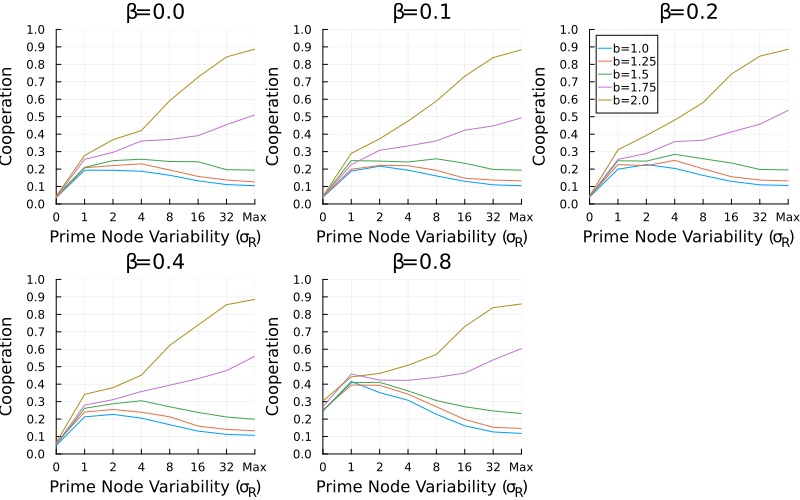

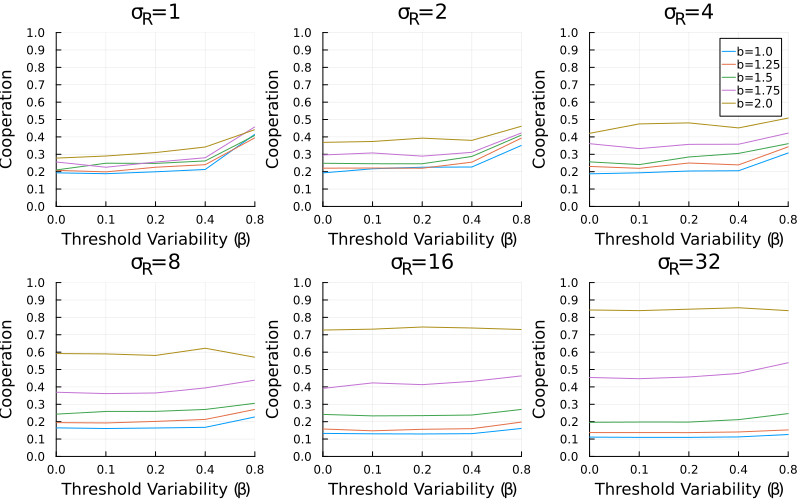

In [14]:
df = sort(df, [:C_rate₀, :peak_node_variability, :relationship_increment_factor, :b, :resource_limit_β])

C_rate₀ = 0.0
resource_limit_σ = 0.1
relationship_increment_factor = 1.0

_df = df[df.C_rate₀ .== C_rate₀ .&& df.resource_limit_σ .== resource_limit_σ .&& df.relationship_increment_factor .== relationship_increment_factor, :]

p_vec = []

for __df in groupby(_df, [:resource_limit_β])
    title = "\\beta=$(__df.resource_limit_β[1])"
    push!(p_vec, one_plot(__df, xticks_peak_node_variability, xlabel_peak_node_variability, title))
end

p = plot(p_vec..., size = (800, 500))
savefig("β.png")
display(p)

p_vec = []

for __df in groupby(_df[0 .< _df.peak_node_variability .< 99, :], [:peak_node_variability])
    title = "\\sigma_{R}=$(__df.peak_node_variability[1])"
    push!(p_vec, one_plot(__df, xticks_resource_limit_β, xlabel_resource_limit_β, title))
end

p = plot(p_vec..., size = (800, 500))
savefig("σR.png")
display(p)